In [1]:
from satpy import Scene, find_files_and_readers
from pyresample import create_area_def
from satpy.writers import get_enhanced_image
from datetime import datetime

import matplotlib.pyplot as plt
import numpy as np
import xarray as xr
from glob import glob

import cartopy.crs as ccrs
import cartopy.feature as cfeature
from cartopy.mpl.gridliner import LONGITUDE_FORMATTER, LATITUDE_FORMATTER

from satpy import MultiScene
from satpy.multiscene import timeseries

%matplotlib inline
import cmocean
import cmocean.cm as cmo

from dask.diagnostics import ProgressBar
from celluloid import Camera
from IPython.display import HTML

import warnings

In [3]:
# uncommomet the files you want 
#filenames = glob('../SAT_DATA/HDF/MODIS_AQUA_APR-2_APR-22_2022_HDF_L1\\MYD021KM.A20221*.hdf')
filenames = glob('../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1/MYD021KM.*.hdf')
filenames.sort()
filenames

['../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021295.1815.061.2021296151433.hdf',
 '../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021295.1955.061.2021296152519.hdf',
 '../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021296.1855.061.2021297151905.hdf',
 '../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021296.1900.061.2021297151948.hdf',
 '../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021297.1805.061.2021298152848.hdf',
 '../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021297.1940.061.2021298152913.hdf',
 '../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021298.1845.061.2021299151938.hdf',
 '../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021299.1930.061.2021300151301.hdf',
 '../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021300.1835.061.2021301151805.hdf',
 '../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021300

In [4]:
# uncommomet the base you want 
#base = '../SAT_DATA/HDF/MODIS_AQUA_APR-2_APR-22_2022_HDF_L1\\MYD021KM.'
base = '../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1/MYD021KM.'

In [7]:
warnings.filterwarnings('ignore')
ax1.annotate(new_scn.start_time.isoformat("|"), (75000,90000), color='black', fontsize=5) #Top Right

NameError: name 'ax1' is not defined

In [8]:
# get the unique values
swats = np.unique([f.split('.')[3] for f in filenames])
swats

array(['A2021295', 'A2021296', 'A2021297', 'A2021298', 'A2021299',
       'A2021300', 'A2021301', 'A2021302', 'A2021303', 'A2021304',
       'A2021305', 'A2021306', 'A2021307', 'A2021308', 'A2021309',
       'A2021310', 'A2021311', 'A2021312', 'A2021313', 'A2021314',
       'A2021315', 'A2021316', 'A2021317', 'A2021318'], dtype='<U8')

['../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021295.1815.061.2021296151433.hdf', '../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021295.1955.061.2021296152519.hdf']


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


['../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021296.1855.061.2021297151905.hdf', '../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021296.1900.061.2021297151948.hdf']


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


['../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021297.1805.061.2021298152848.hdf', '../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021297.1940.061.2021298152913.hdf']


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


['../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021298.1845.061.2021299151938.hdf']


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


['../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021299.1930.061.2021300151301.hdf']


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


['../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021300.1835.061.2021301151805.hdf', '../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021300.2010.061.2021301152744.hdf', '../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021300.2015.061.2021301152822.hdf']


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


['../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021301.1915.061.2021302173041.hdf', '../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021301.1920.061.2021302173055.hdf']


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


['../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021302.1820.061.2021303154655.hdf', '../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021302.2000.061.2021303154433.hdf']


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


['../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021303.1905.061.2021304152133.hdf']


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


['../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021304.1810.061.2021305150643.hdf', '../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021304.1945.061.2021305150843.hdf', '../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021304.1950.061.2021305151614.hdf']


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


['../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021305.1850.061.2021306152526.hdf', '../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021305.1855.061.2021306152546.hdf']


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


['../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021306.1935.061.2021307152842.hdf']


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


['../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021307.1840.061.2021308153223.hdf', '../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021307.2020.061.2021308153252.hdf']


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


['../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021308.1920.061.2021309154438.hdf', '../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021308.1925.061.2021309154000.hdf']
['../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021309.1825.061.2021310154058.hdf', '../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021309.1830.061.2021310154053.hdf', '../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021309.2005.061.2021310154120.hdf']


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


['../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021310.1910.061.2021311155318.hdf']


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


['../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021311.1815.061.2021312154141.hdf', '../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021311.1955.061.2021312154258.hdf']


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


['../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021312.1855.061.2021313154516.hdf', '../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021312.1900.061.2021313154455.hdf']


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


['../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021313.1805.061.2021315024721.hdf', '../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021313.1940.061.2021315024114.hdf', '../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021313.1945.061.2021315024103.hdf']


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


['../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021314.1845.061.2021315152657.hdf']


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


['../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021315.1930.061.2021316184746.hdf']


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


['../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021316.1835.061.2021317154148.hdf', '../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021316.2010.061.2021317154246.hdf', '../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021316.2015.061.2021317155504.hdf']


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


['../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021317.1915.061.2021318153446.hdf', '../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021317.1920.061.2021318153453.hdf']


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


['../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021318.1820.061.2021320193748.hdf', '../SAT_DATA/HDF/MODIS_AQUA_OCT-22_NOV-14_2022_HDF_L1\\MYD021KM.A2021318.2000.061.2021320193817.hdf']


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Animation size has reached 21837362 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


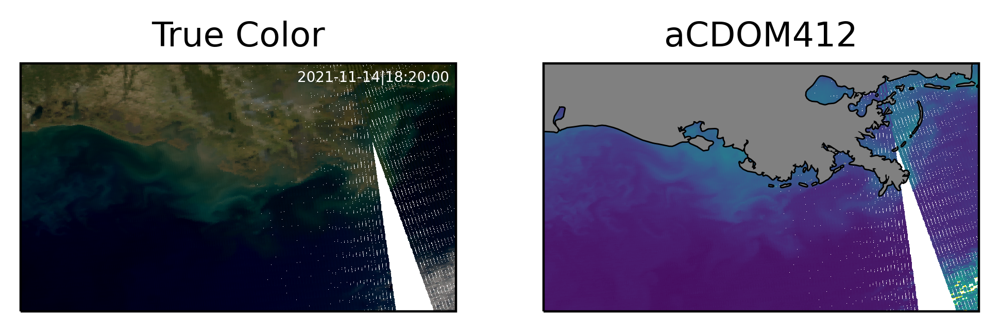

In [9]:
res = '10m'
extent=[-94, 27.5, -88, 30.5]

#Define Camera & Figure
fig =  plt.figure(figsize=(6, 2), dpi=400)
camera = Camera(fig)

#constants
A = 0.472; B = 1.48; C = 4.64

my_area = create_area_def('my_area', {'proj': 'lcc', 'lon_0': -91., 'lat_0': 29.5, 'lat_1': 29.5, 'lat_2': 29.5},
                          width=1500, height=750,
                          area_extent=extent, units='degrees')
    
for swat in swats:
    dayfiles = glob(base+swat+'*')
    print(dayfiles)
    scn = Scene(dayfiles, reader='modis_l1b')
    scn.load(['10','4'])
    scn.load(['true_color'])

    #reproject
    new_scn = scn.resample(my_area)

    #generate RGB from true color
    rgb = get_enhanced_image(new_scn['true_color'])

    #calculate aCDOM
    aCDOM412 = (np.log((new_scn['10']/new_scn['4'] - A)/ B))/(-C)
    aCDOM412 = aCDOM412.compute()

    #extract projection and lon lat from products
    crs = new_scn['true_color'].attrs['area'].to_cartopy_crs()
    lons, lats = new_scn['true_color'].attrs['area'].get_lonlats()

    #left true color
    ax1 = plt.subplot(1, 2, 1, projection=crs)
    rgb.data.plot.imshow(rgb='bands', transform=crs, ax=ax1)
    ax1.set_title('True Color')
    ax1.annotate(new_scn.start_time.isoformat("|"), (75000,90000), color='white', fontsize=5) #Top Right
    
    #right aCDOM
    trim = aCDOM412.max().values
    ax2 = plt.subplot(1, 2, 2, projection=crs)
    #costline with specified resolution
    ax2.coastlines(res)
    #this is ploting x,y, aCDOM
    ax2.pcolormesh(lons, lats, aCDOM412.where(aCDOM412<=trim), transform=ccrs.PlateCarree(),
                  vmin=.01, vmax=.3)
    #mask the land
    ax2.add_feature(cfeature.NaturalEarthFeature(category='physical', 
                                                name='land', facecolor='grey',
                                                scale=res))
    ax2.set_title('aCDOM412')
    
    #Add frame
    camera.snap()

#Create animation & Display embedded animation
animation = camera.animate(interval = 1000)
HTML(animation.to_jshtml())

In [10]:
animation.save('../MAPS_Figures/MODIS_Animation_GOM21FA.mp4')